# Pre-Processing of Data

In [2]:
# Misc
import os
import sys
from timeit import default_timer as timer 
import datetime
now = datetime.datetime.now()

# Data manipulation
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from netCDF4 import Dataset
import numpy as np
import plotly.graph_objects as go
from scipy.optimize import curve_fit
from scipy.stats import norm


# Sanity check for jupyter notebooks
print("Current working directory:", os.getcwd())

Current working directory: c:\Users\gabri\Documents\GitHub\IceClassic\sandbox\content


# Loading the dataframe
The source and explanation of each column is in the txt.

In [3]:
Data=pd.read_csv('Time_series_DATA.txt',skiprows=149,index_col=0)
Data.index=pd.to_datetime(Data.index)
Data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 41351 entries, 1854-01-01 to 2024-02-06
Data columns (total 26 columns):
 #   Column                                             Non-Null Count  Dtype  
---  ------                                             --------------  -----  
 0   Regional: Air temperature [C]                      38563 non-null  float64
 1   Days since start of year                           38563 non-null  float64
 2   Days until break up                                38563 non-null  float64
 3   Predicted ice thickness [m]                        38563 non-null  float64
 4   Noisy predicted ice thickness [m]                  25762 non-null  float64
 5   Nenana: Rainfall [mm]                              29547 non-null  float64
 6   Nenana: Snowfall [mm]                              19945 non-null  float64
 7   Nenana: Snow depth [mm]                            15984 non-null  float64
 8   Nenana: Mean water temperature [C]                 2418 non-null   fl

# Visualizing the dataframe


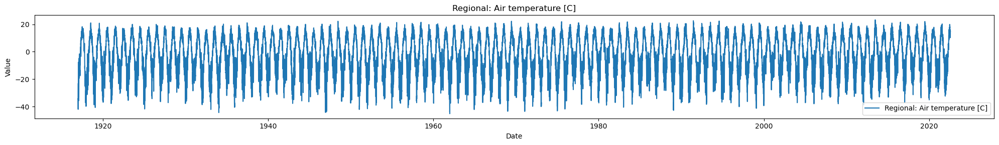

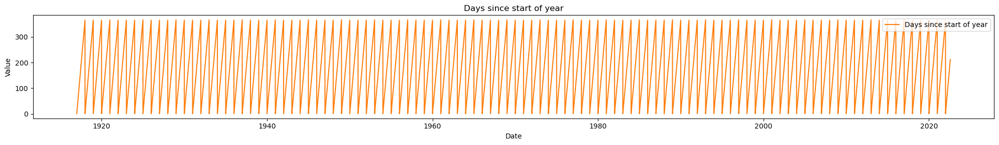

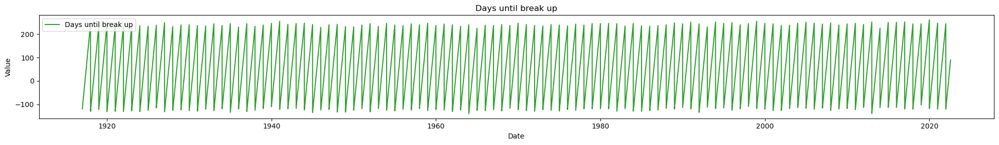

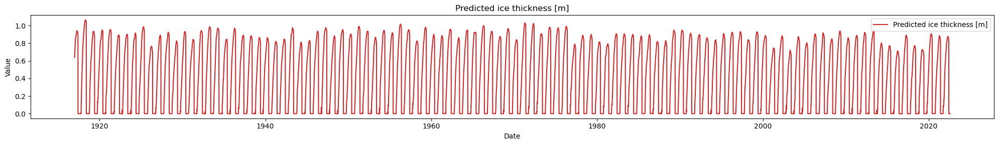

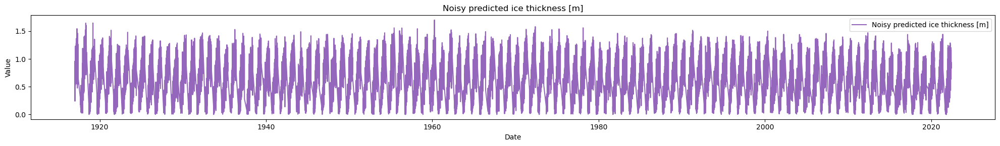

...

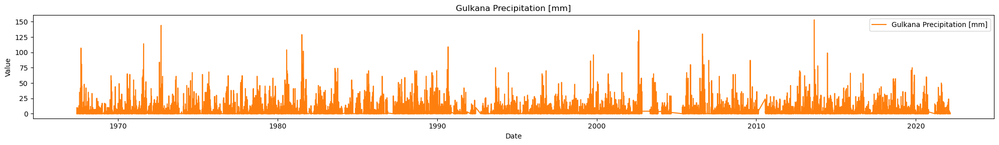

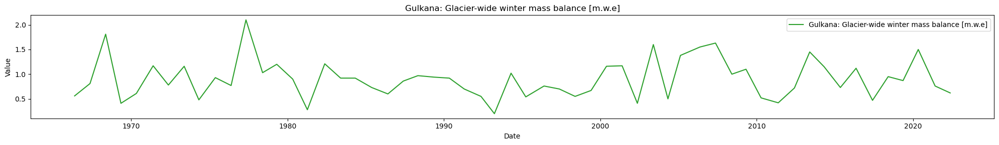

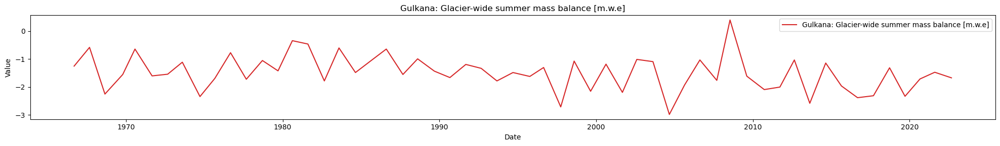

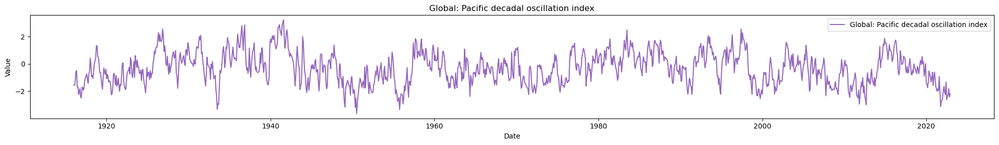

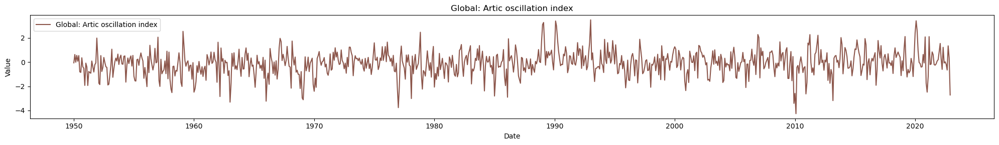

In [4]:

Data =Data[Data.index.year >= 1916]
Data=Data[Data.index.year<=2022]

for i, col in enumerate(Data.columns):
    col_data = Data[col].copy()
    col_data.dropna(inplace=True)
    if not col_data.empty: 
        plt.figure(figsize=(20, 3))
        plt.plot(col_data.index, col_data.values, label=col, color=plt.cm.tab10(i % 10))
        plt.legend()
        plt.xlabel('Date')
        plt.ylabel('Value')
        plt.title(col)
        plt.tight_layout()
        plt.show()

In [5]:
# ploting 'sparse columns' does not work very well ( scatter works jsut fines), so we created sanitized verison simialr as we did in the plots above, also lets drop vert old data

Data_clouds= Data.dropna(subset=['Regional: Cloud coverage [%]']).copy()
Data_ice= Data.dropna(subset=['IceThickness [cm]']).copy()
Data_solar= Data.dropna(subset=['Regional: Solar Surface Irradiance [W/m2]']).copy()

# Initialize figure
fig = go.Figure()

# Add Traces ( plots elements)
fig.add_trace(go.Scatter(x=[None], y=[None], mode='lines', name='break up date', line=dict(color='red', width=0.4, dash='dot')))
fig.add_trace(go.Scatter(x=Data.index,y=Data["Regional: Air temperature [C]"],name="Air temp",yaxis="y",line=dict(color='gold')))
fig.add_trace(go.Scatter(x=Data.index,y=Data["Predicted ice thickness [m]"]*100,name="Predicted ice thickness",yaxis="y4",line=dict(color='lime')))
fig.add_trace(go.Scatter(x=Data_ice.index,y=Data_ice["IceThickness [cm]"],name="Ice thickness",yaxis="y4",line=dict(color='navy')))
fig.add_trace(go.Scatter(x=Data.index,y=Data["Nenana: Rainfall [mm]"],name="Rainfall",yaxis="y2",line=dict(color='lightseagreen')))
fig.add_trace(go.Scatter(x=Data.index,y=Data["Nenana: Snowfall [mm]"],name="Snowfall",yaxis="y2",line=dict(color='slateblue')))
fig.add_trace(go.Scatter(x=Data.index,y=Data["Nenana: Snow depth [mm]"],name='Snow depth',yaxis="y2",line=dict(color='magenta')))
fig.add_trace(go.Scatter(x=Data.index,y=Data['Nenana: Mean water temperature [C]'],name="Water temp",yaxis="y",line=dict(color='firebrick')))
fig.add_trace(go.Scatter(x=Data.index,y=Data['Nenana: Mean Discharge [m3/s]'],name="Discharge",yaxis="y3",line=dict(color='dodgerblue')))
fig.add_trace(go.Scatter(x=Data_clouds.index,y=Data_clouds["Regional: Cloud coverage [%]"],name="Cloud coverage",yaxis="y5",line=dict(color='slategray')))
fig.add_trace(go.Scatter(x=Data_solar.index,y=Data_solar["Regional: Solar Surface Irradiance [W/m2]"],name="Solar Surface Irradiance",yaxis="y6",line=dict(color='orangered')))
# dropdown menu to select which timseries to plot
# fig.update_layout(
#     updatemenus=[
#         dict(active=0,
#             buttons=list([
#                 dict(label="All",method="update",args=[{"visible": [True, True, True,True,True, True, True,True,True,True]}]),
#                 dict(label="Temperature",method="update",args=[{"visible":  [True, False, False,False,False, False,True,False,False,False]}]),
#                 dict(label="Ice+Snow",method="update",args=[{"visible":    [False,True,True,False,True,True,False,False,False,False]}]),
#                 dict(label="Discharge+Rain",method="update",args=[{"visible":   [False, False, False,True,False, False,False,True,False,False]}]),
#                 dict(label="Clouds+Solar Radiation",method="update",args=[{"visible":   [False, False, False,False,False, False,False,False,True,True]}])]),)])


break_up_times=pd.read_csv('https://github.com/GabrielFollet/ICE_data_dump/blob/main/BreakUpTimes.csv?raw=true')
break_up_times.head()
break_up_times['timestamp'] = pd.to_datetime(break_up_times[['Year', 'Month', 'Day']])  # want index wiht only date not time
break_up_times['timestamps'] = pd.to_datetime(break_up_times['timestamp'])
break_up_times.set_index('timestamp', inplace=True)
shapes = []
for date in break_up_times.index:
    shape = {"type": "line","xref": "x","yref": "paper","x0": date,"y0": 0,"x1": date,"y1": 1,"line": {"color": 'red',"width": 0.6,"dash": 'dot'},'name':'break up time'}
    shapes.append(shape)

fig.update_layout(shapes=shapes)

# Set title and axis properties
fig.update_layout(
    title="Break up times & Global Variables at Tenana River-Nenana,AK",
    showlegend=True,
    xaxis=dict(range=["2010-10-01","2011-06-31"],rangeslider=dict(autorange=True),type="date"),
    yaxis=dict(anchor="x",autorange=True,domain=[0, 0.17],linecolor="black",mirror=True,range=[-55.0, 25],
            showline=True,side="left",tickfont={"color": "black"},tickmode="auto",ticks="",title="[C]",
            titlefont={"color": "black"},type="linear",zeroline=False),
    yaxis2=dict(anchor="x",autorange=True,domain=[0.17, 0.34],linecolor="black",mirror=True,range=[0, 50],
            showline=True,side="left",tickfont={"color": "black"},tickmode="auto",ticks="",title="[mm]",
            titlefont={"color": "black"},type="linear",zeroline=False),
    yaxis3=dict(anchor="x",autorange=True,domain=[0.34, 0.51],linecolor="black",mirror=True,range=[0,30],
            showline=True,side="left",tickfont={"color": "black"},tickmode="auto",ticks="",title="[m3/s]",
            titlefont={"color": "black"},type="linear",zeroline=False),
    yaxis4=dict(anchor="x",autorange=True,domain=[0.51, .68],linecolor="black",mirror=True,range=[0,200],
            showline=True,side="left",tickfont={"color": "black"},tickmode="auto",ticks="",title="[cm]",
            titlefont={"color": "black"},type="linear",zeroline=False),
    yaxis5=dict(anchor="x",autorange=True,domain=[0.68, 0.85],linecolor="black",mirror=True,range=[0,200],
            showline=True,side="left",tickfont={"color": "black"},tickmode="auto",ticks="",title="[%]",
            titlefont={"color": "black"},type="linear",zeroline=False),
    yaxis6=dict(anchor="x",autorange=True,domain=[0.85, 1],linecolor="black",mirror=True,range=[0,200],
            showline=True,side="left",tickfont={"color": "black"},tickmode="auto",ticks="",title="[W/m2]",
            titlefont={"color": "black"},type="linear",zeroline=False))


# Update layout
fig.update_layout(
    dragmode="zoom",hovermode="x",legend=dict(traceorder="reversed"),height=800,template="plotly",
        margin=dict(t=90,b=90),)

fig.show()


We have added the **["Days until break up']** and **['Days since start of year']** columns to plot the variables before and after the break up

#

In [6]:

# Initialize figure
fig = go.Figure()

# Add Traces ( plots elements)
fig.add_trace(go.Scatter(x=Data.index,y=Data["Predicted ice thickness [m]"]*100,name="Predicted ice thickness",yaxis="y4",line=dict(color='lime')))
fig.add_trace(go.Scatter(x=Data_ice.index,y=Data_ice["IceThickness [cm]"],name="Ice thickness",yaxis="y4",line=dict(color='navy')))
fig.add_trace(go.Scatter(x=Data.index,y=Data["Nenana: Snow depth [mm]"]/10,name='Snow depth',yaxis="y4",line=dict(color='magenta')))
# Set title and axis properties
fig.update_layout(
    title="Predicted ice thickness",
    showlegend=True,
    xaxis=dict(range=["1990-01-01","1995-12-31"],rangeslider=dict(autorange=True),type="date"),
    yaxis4=dict(anchor="x",autorange=True,linecolor="black",mirror=True,range=[0,200],
            showline=True,side="left",tickfont={"color": "black"},tickmode="auto",ticks="",title="[cm]",
            titlefont={"color": "black"},type="linear",zeroline=False))
shapes = []
for date in break_up_times.index:
    shape = {"type": "line","xref": "x","yref": "paper","x0": date,"y0": 0,"x1": date,"y1": 1,"line": {"color": 'red',"width": 0.9,"dash": 'dot'},'name':'break up time'}
    shapes.append(shape)

fig.update_layout(shapes=shapes)
fig.update_layout(
    dragmode="zoom",hovermode="x",legend=dict(traceorder="reversed"),height=800,template="plotly",
        margin=dict(t=90,b=150),)

fig.show()


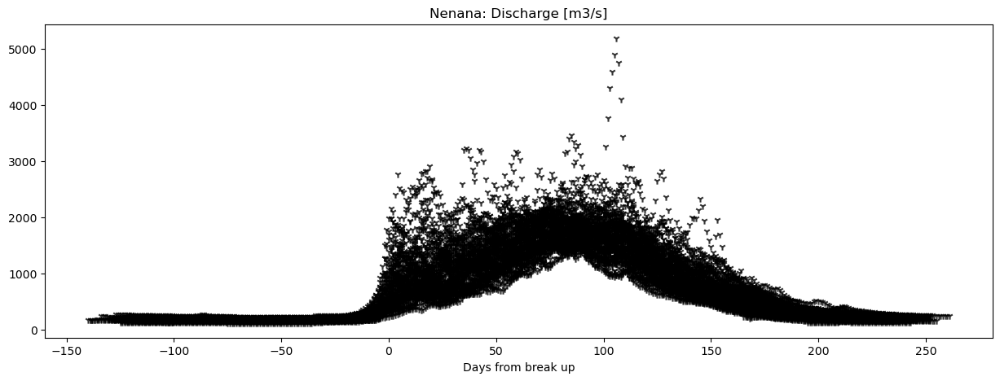

In [7]:
fig, ax1 = plt.subplots(1,1,figsize=(15,5)) 
plt.scatter(Data['Days until break up'],Data['Nenana: Mean Discharge [m3/s]'],color='k',marker='1',alpha=0.8)
plt.xlabel('Days from break up')
plt.title("Nenana: Discharge [m3/s]")
plt.show()

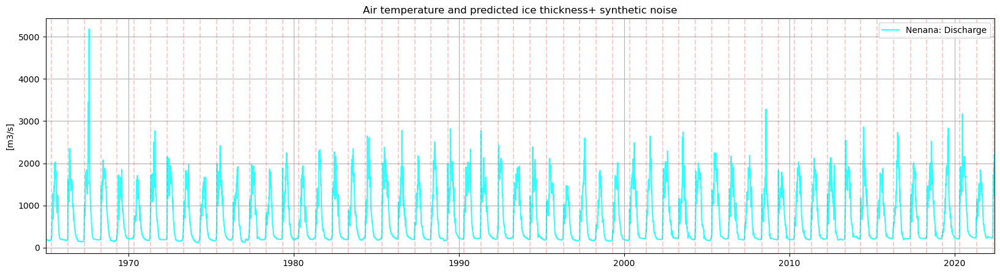

In [8]:
fig, ax = plt.subplots(1, 1, figsize=(20, 5))
ax.set_title('Air temperature and predicted ice thickness+ synthetic noise')
ax.grid(True)


ax.plot(Data['Nenana: Mean Discharge [m3/s]'], color="aqua", alpha=0.8, label='Nenana: Discharge')
ax.set_ylabel( '[m3/s]')
ax.set_xlim([pd.to_datetime('1965-01-01'),pd.to_datetime('2022-06-01')])
ax.legend()
# Plot vertical lines where the values are 0= break up date
zero_indices = Data.index[Data['Days until break up'] == 0]
for zero_index in zero_indices:
    plt.axvline(x=zero_index, color='r', linestyle='--',alpha=0.2)


# Show plot
plt.show()

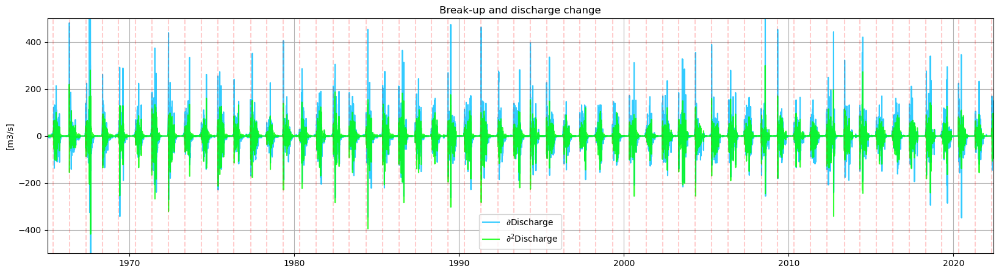

In [9]:
dy_dx = np.gradient((Data['Nenana: Mean Discharge [m3/s]']))
dy2_dx = np.gradient(dy_dx)

fig, ax = plt.subplots(1, 1, figsize=(20, 5))
ax.set_title('Break-up and discharge change')
ax.grid(True)


ax.plot(Data.index,dy_dx, color="deepskyblue", alpha=0.8, label=r'$\partial$'+ 'Discharge')
ax.plot(Data.index,dy2_dx, color="lime", alpha=0.8,label=r'$\partial^2$'+ 'Discharge')
ax.set_ylabel( '[m3/s]')
ax.set_xlim([pd.to_datetime('1965-01-01'),pd.to_datetime('2022-06-01')])
ax.legend()
# Plot vertical lines where the values are 0= break up date
zero_indices = Data.index[Data['Days until break up'] == 0]
for zero_index in zero_indices:
    plt.axvline(x=zero_index, color='r', linestyle='--',alpha=0.2)

plt.ylim([-500,500])
# Show plot
plt.show()

## Glacier Data

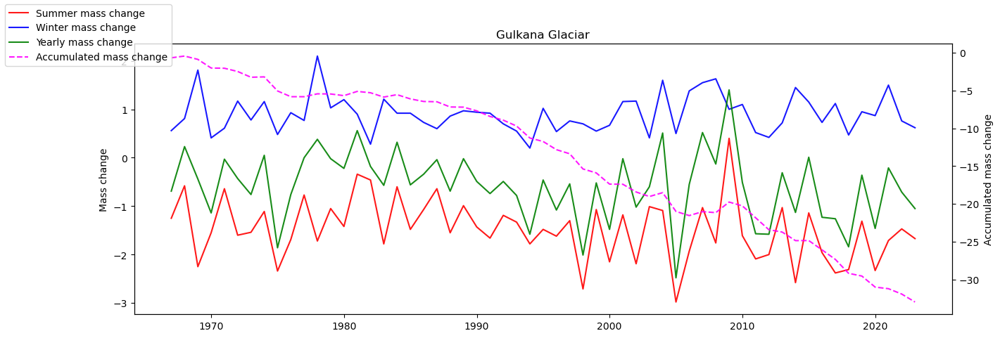

In [10]:
Glaciar_summer=Data['Gulkana: Glacier-wide summer mass balance [m.w.e]'].copy().resample('Y').mean().dropna()
Glaciar_winter=Data['Gulkana: Glacier-wide winter mass balance [m.w.e]'].copy().resample('Y').mean().dropna()
Glaciar_year=Glaciar_winter+Glaciar_summer


fig, ax1 = plt.subplots(1, 1, figsize=(15, 5))
ax1.plot(Glaciar_summer, label='Summer mass change', alpha=0.9, color='r')
ax1.plot(Glaciar_winter, label='Winter mass change', alpha=0.9, color='b')
ax1.plot(Glaciar_year, label='Yearly mass change', alpha=0.9, color='g')
ax1.set_ylabel('Mass change')


ax2 = ax1.twinx()

integral = Glaciar_year.cumsum()
ax2.plot(Glaciar_year.index, integral, label='Accumulated mass change', alpha=0.9, color='magenta',linestyle='--')
ax2.set_ylabel('Accumulated mass change')

# Set title and legend
plt.title('Gulkana Glaciar')
fig. legend(loc='upper left')

plt.show()

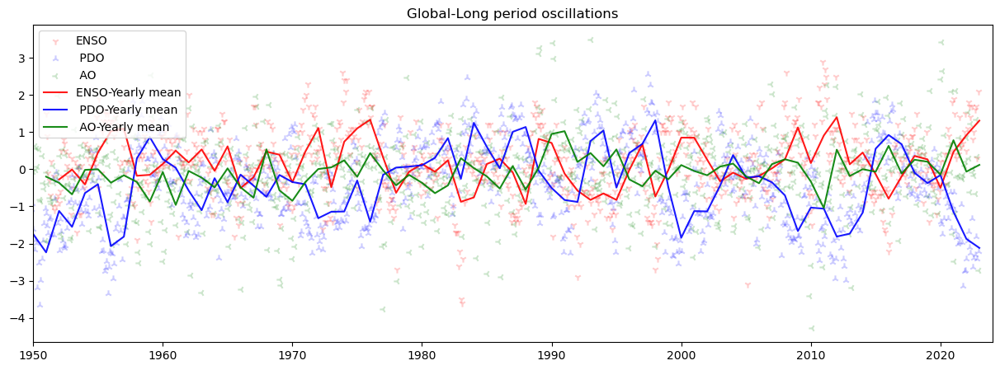

In [11]:
ENSO=Data['Global: ENSO-Southern oscillation index'].copy().resample('Y').mean().dropna()
ENSO.index=pd.to_datetime(ENSO.index)
PDO=Data['Global: Pacific decadal oscillation index'].copy().resample('Y').mean().dropna()
PDO.index=pd.to_datetime(PDO.index)
AO=Data['Global: Artic oscillation index'].copy().resample('Y').mean().dropna()
AO.index=pd.to_datetime(AO.index)
fig, ax1 = plt.subplots(1,1,figsize=(15,5)) 

plt.scatter(Data.index,Data['Global: ENSO-Southern oscillation index'],label='ENSO',alpha=0.2,marker='1',color='r')
plt.scatter(Data.index,Data['Global: Pacific decadal oscillation index'],label=' PDO',alpha=0.2,marker='2',color='b')
plt.scatter(Data.index,Data['Global: Artic oscillation index'],label=' AO',alpha=0.2,marker='3',color='g')

plt.plot(ENSO,label='ENSO-Yearly mean',alpha=0.9,color='r')
plt.plot(PDO,label=' PDO-Yearly mean',alpha=0.9,color='b')
plt.plot(AO,label=' AO-Yearly mean',alpha=0.9,color='g')
plt.title('Global-Long period oscillations')
plt.xlim([pd.to_datetime('1950-01-01'),pd.to_datetime('2024-01-01')])
plt.legend(loc='upper left')
plt.show()